<a href="https://colab.research.google.com/github/Aditya0996/DataAnalysis-CaliforniaHousing/blob/main/Data_Analysis_California_Housing_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#load the dataset
from sklearn.datasets import fetch_california_housing

california_housing = fetch_california_housing(as_frame=True)

In [ ]:
df = california_housing.frame

In [ ]:
import numpy as np
from sklearn.cluster import KMeans
from sklearn.neighbors import KNeighborsClassifier
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp
import pandas as pd
import seaborn as sns
from sklearn.metrics import silhouette_score

# Data Exploration and Discovery

In [ ]:
df

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422
...,...,...,...,...,...,...,...,...,...
20635,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09,0.781
20636,2.5568,18.0,6.114035,1.315789,356.0,3.122807,39.49,-121.21,0.771
20637,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22,0.923
20638,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32,0.847


The **min/max/median/averge value** and **standard deviations** for different features.
We can see using standard deviation that population feature has a wide spread of data points.

In [ ]:
df.describe()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704,2.068558
std,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532,1.153956
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000,0.149990
25%,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000,1.196000
50%,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000,1.797000
75%,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000,2.647250
max,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000,5.000010


In [ ]:
fig = px.box(df, orientation='h')
fig.update_layout(
    title="Box Plot for Features",
    xaxis_title="Feature Values",
    yaxis_title="Features",
)

fig.show()

Check for outliers - We can see that population, average rooms, average bedrooms, and average occupation features have outliers as they have values above the fence. We can also see the max values of Average rooms, average bedrooms, average occupation are much higher than the mean of respective feature.

<Figure size 1200x1000 with 0 Axes>

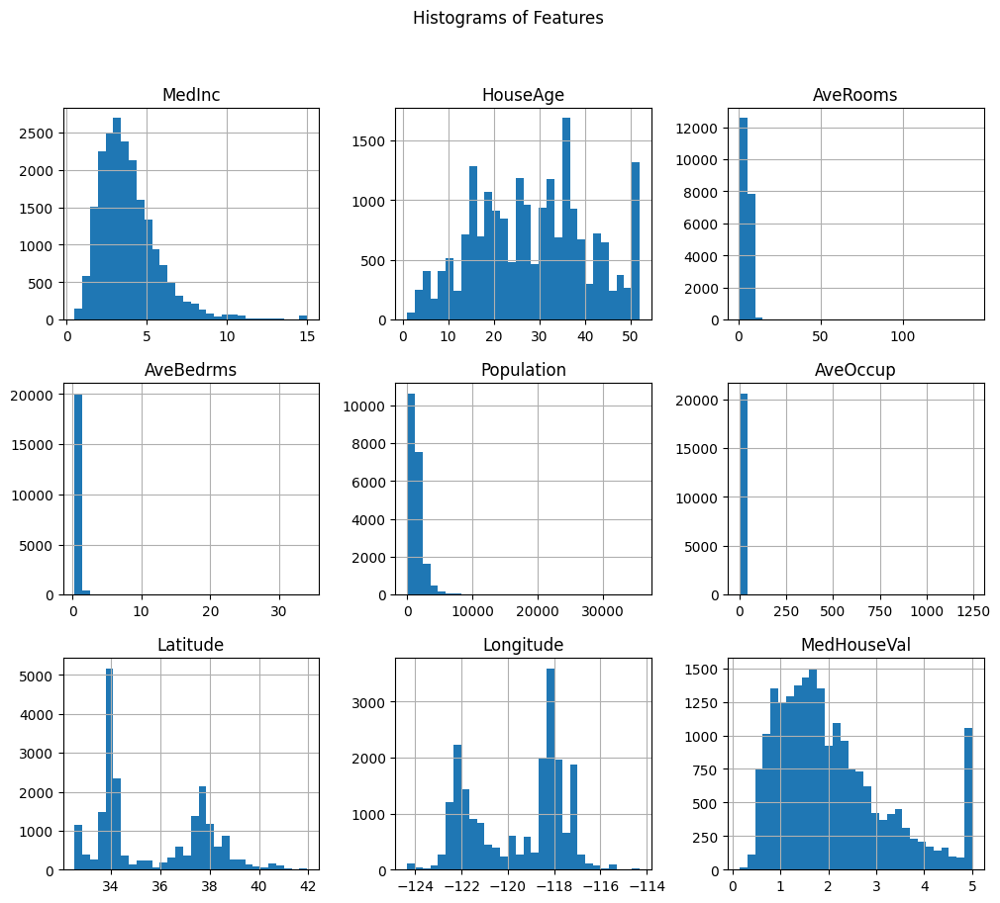

In [ ]:
plt.figure(figsize=(12, 10))
df.hist(bins=30, figsize=(12, 10))
plt.suptitle("Histograms of Features")
plt.show()

Check for odd patterns: From the histogram of MedHouseVal, the frequency of values are decreasing as value rises but it has a sudden increase at the end.

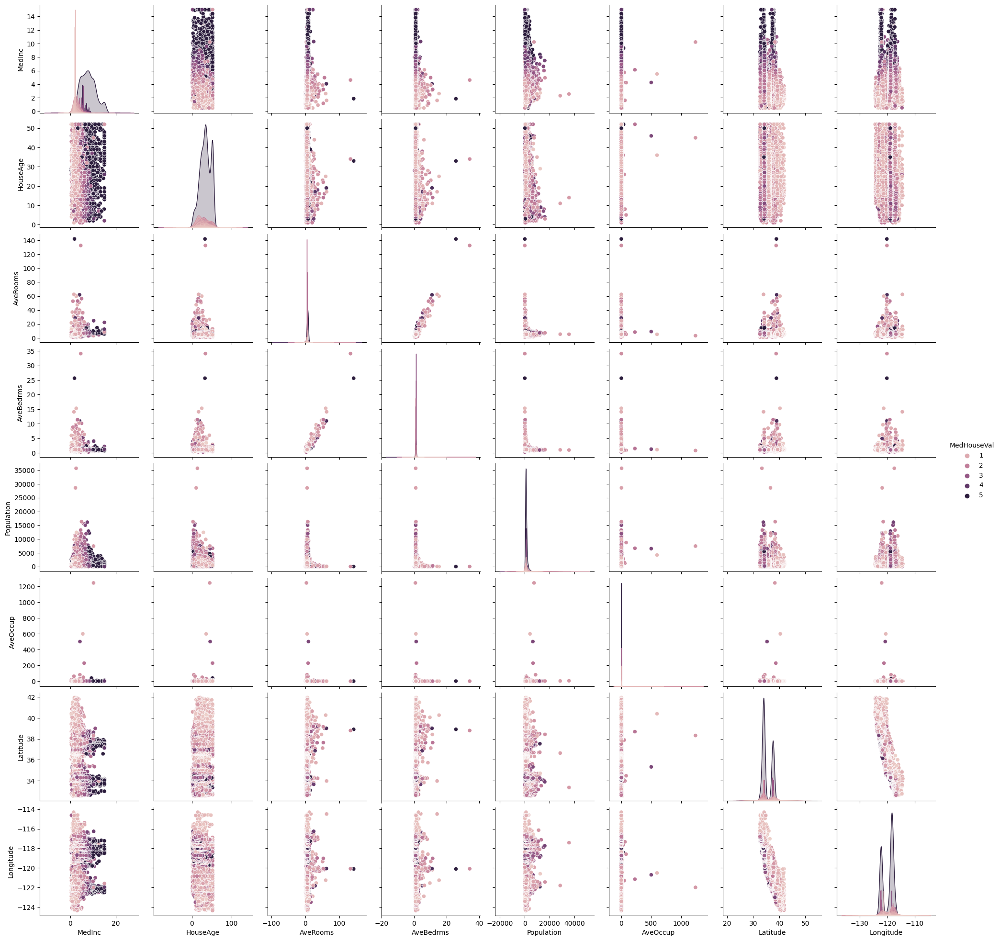

In [ ]:
sns.pairplot(df, hue='MedHouseVal')

# Data pre-processing

Source: https://medium.com/@d19it154/data-preprocessing-using-scikit-learn-california-housing-prices-dataset-7dd0a24f88c9

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
df_standardized = scaler.fit_transform(df)
df_standardized = pd.DataFrame(df_standardized, columns=df.columns)

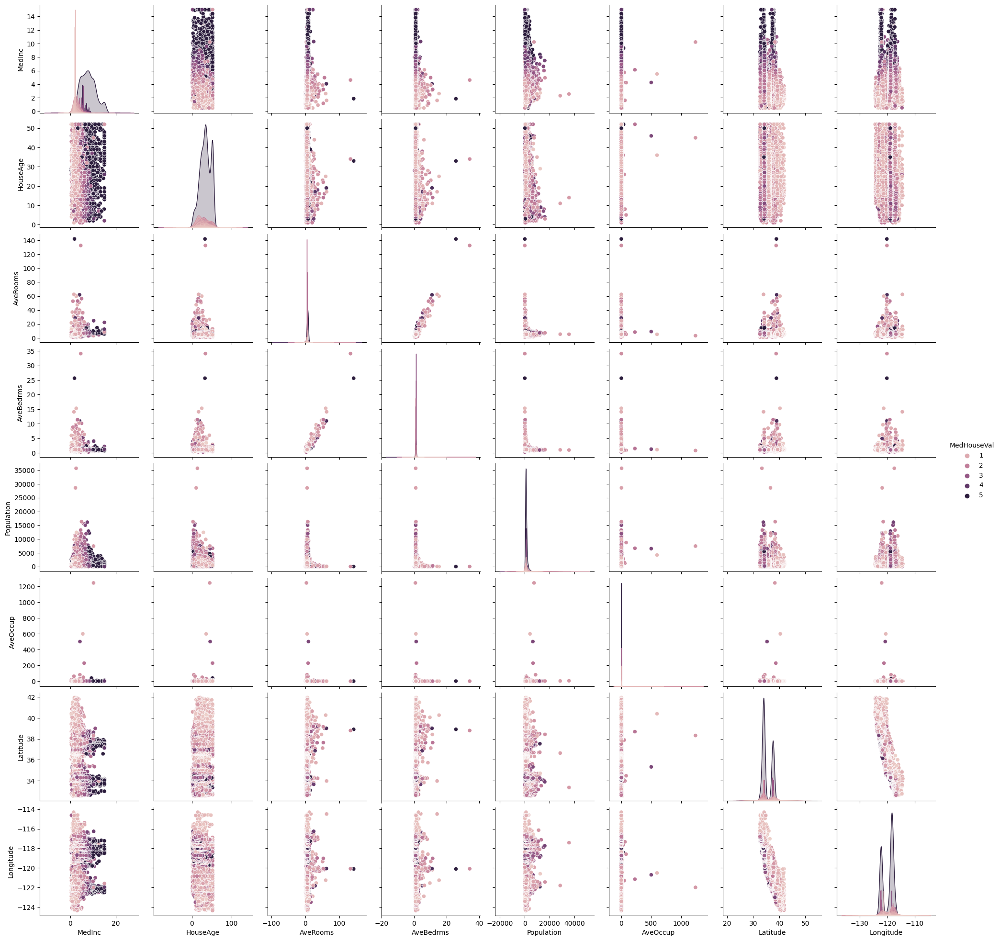

In [ ]:
# Pairplot after standardization
sns.pairplot(df, hue='MedHouseVal')

In [ ]:
fig = px.scatter_3d(df_standardized, x='MedInc', y='Population', z='HouseAge', color = 'MedHouseVal')
fig.show()

In [ ]:
fig = px.scatter_3d(df_standardized, x='AveRooms', y='AveBedrms', z='AveOccup', color = 'MedHouseVal')
fig.show()

In [ ]:
fig = px.scatter_3d(df_standardized, x='Latitude', y='Longitude', z='AveRooms', color = 'MedHouseVal')
fig.show()

Check for outliers after standardization:

In [ ]:
fig = px.box(df_standardized, orientation='h')
fig.update_layout(
    title="Box Plot for Features",
    xaxis_title="Feature Values",
    yaxis_title="Features",
)

fig.show()

After plotting 2d and 3d scatterplots and Box plot we can see that there are outliers in "AveBedrms", "Population", "AveOccup", "AveRooms" and "MedInc".  I used IQR Based Filtering to remove the outliers with a 0.25 - 0.75 percentile limit and threshold of 1.5

Source:

https://pandas.pydata.org/docs/user_guide/indexing.html#evaluation-order-matters

https://www.analyticsvidhya.com/blog/2021/05/feature-engineering-how-to-detect-and-remove-outliers-with-python-code/#:~:text=Outliers%20can%20be%20treated%20in,do%20so%20in%20skewed%20distributions.

In [ ]:
df_without_outliers = df_standardized.copy()
outliers_columns = ["AveBedrms", "Population", "AveOccup", "AveRooms", "MedInc"]
for x in outliers_columns:
  # calculate IQR for column x
  Q1 = df_standardized[x].quantile(0.25)
  Q3 = df_standardized[x].quantile(0.75)
  IQR = Q3 - Q1

  # identify outliers
  threshold = 1.5
  outliers = df_without_outliers[(df_without_outliers[x] < Q1 - threshold * IQR) | (df_without_outliers[x] > Q3 + threshold * IQR)]
  df_without_outliers = df_without_outliers.drop(outliers.index)


After removing the outliers I have plotted the 2d and 3d scatterplots and box plot below. We can see very clearly in the box plot that outliers have been removed

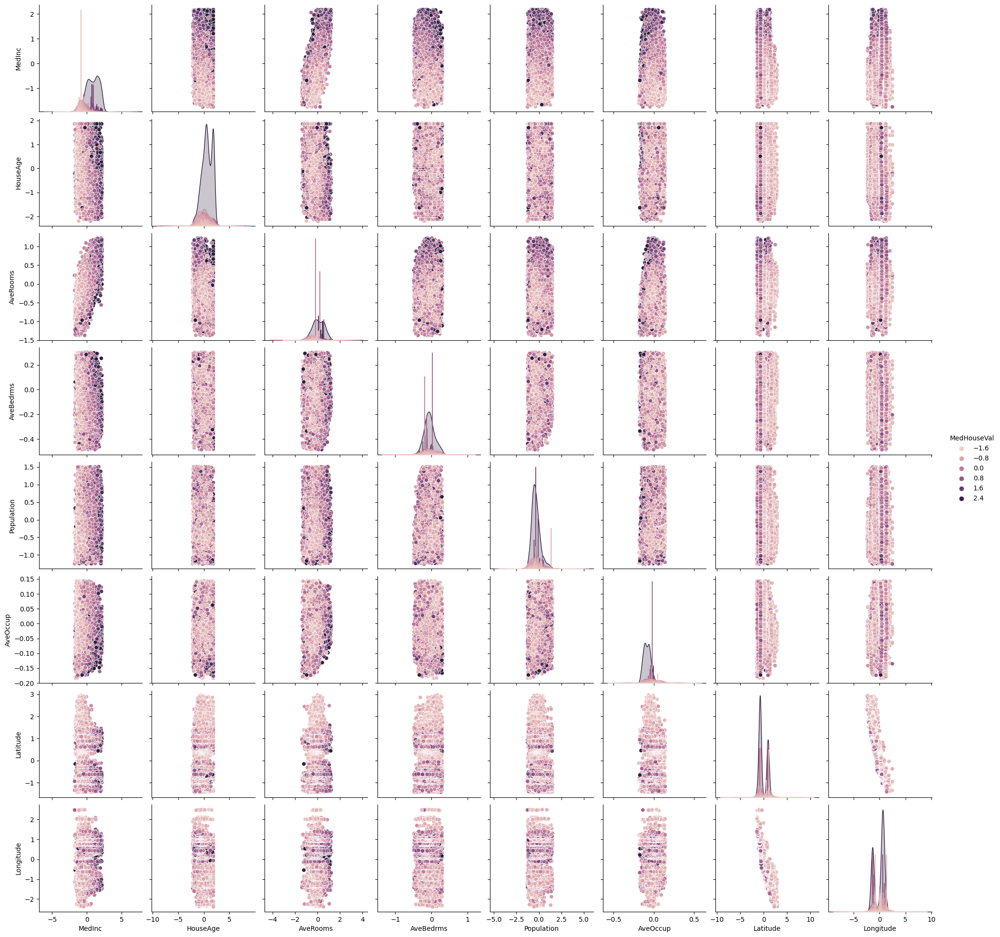

In [ ]:
sns.pairplot(df_without_outliers, hue='MedHouseVal')

In [ ]:
fig = px.scatter_3d(df_without_outliers, x='Latitude', y='Longitude', z='AveRooms', color = 'MedHouseVal')
fig.show()

In [ ]:
fig = px.scatter_3d(df_without_outliers, x='AveRooms', y='AveBedrms', z='AveOccup', color = 'MedHouseVal')
fig.show()

In [ ]:
fig = px.scatter_3d(df_without_outliers, x='MedInc', y='Population', z='HouseAge', color = 'MedHouseVal')
fig.show()

In [ ]:
fig = px.box(df_without_outliers, orientation='h')
fig.update_layout(
    title="Box Plot for Features",
    xaxis_title="Feature Values",
    yaxis_title="Features",
)

fig.show()

Check for null values

In [ ]:
df_without_outliers.isnull().sum()

MedInc         0
HouseAge       0
AveRooms       0
AveBedrms      0
Population     0
AveOccup       0
Latitude       0
Longitude      0
MedHouseVal    0
dtype: int64

In [ ]:
sliced_df = df_without_outliers.drop(columns=["MedHouseVal"])

In [ ]:
pca = PCA()
data = pca.fit_transform(sliced_df)
pca.explained_variance_ratio_.cumsum()

array([0.47712909, 0.73080331, 0.89591933, 0.96238857, 0.98554484,
       0.9951748 , 0.99922839, 1.        ])

Note: 3 number of PCA components can help us best visualize our data. As seen above from cumulative sum of explained variance ratio, we can capture 89.5% of total variance in 3 dimensions.

In [ ]:
pca1 = PCA(n_components=3)
reduced_array = pca1.fit_transform(sliced_df)
pca1.explained_variance_ratio_

array([0.47712909, 0.25367422, 0.16511602])

##Clustering:
As seen in the plot below 2 or 3 looks optimal number of clusters as in an elbow plot we have have to see the points just before the elbow joint.

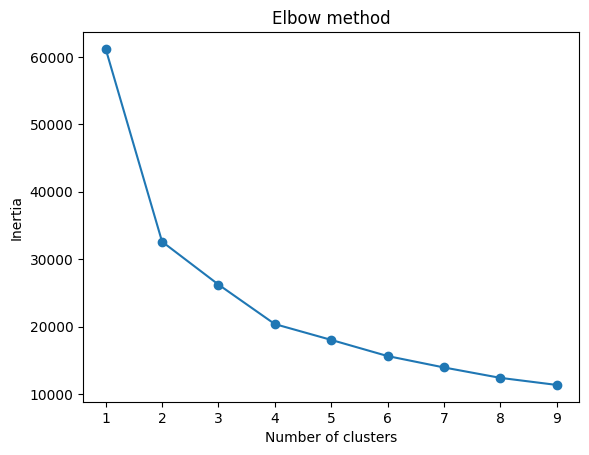

In [ ]:
inertias = []

for i in range(1,10):
    kmeans = KMeans(n_clusters=i, n_init='auto')
    kmeans.fit(reduced_array)
    #inertia: Sum of squared distances of samples to their closest cluster center
    inertias.append(kmeans.inertia_)

plt.plot(range(1,10), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

# Data Analysis

Source: https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

Silhouette score: It provides a measure of how similar an object is to its own cluster (cohesion) compared to other clusters (separation). A high Silhouette score indicates that the object is well matched to its own cluster and poorly matched to neighboring clusters. This is indicative of a good clustering. Hence, this metric help with determining the number of clusters.

In [ ]:
n_clusters = range(2, 16)
silhouette_scores = []

for n in n_clusters:
    KMean = KMeans(n_clusters=n, n_init='auto')
    labels = KMean.fit_predict(reduced_array)
    silhouette = silhouette_score(reduced_array, labels)
    silhouette_scores.append(silhouette)
    print(f'Silhouette Score(n={n}): {silhouette}')

# Create a DataFrame to store the results
results_df = pd.DataFrame({'n_clusters': n_clusters, 'silhouette_score': silhouette_scores})

# Create a Plotly figure for the silhouette score vs. n_clusters
fig = px.line(results_df, x='n_clusters', y='silhouette_score', title='Silhouette Score vs. Number of Clusters')
fig.show()

Silhouette Score(n=2): 0.43553109565896675
Silhouette Score(n=3): 0.3853947097798533
Silhouette Score(n=4): 0.33012106857684453
Silhouette Score(n=5): 0.3260231891434803
Silhouette Score(n=6): 0.31830149187745677
Silhouette Score(n=7): 0.3096338482533216
Silhouette Score(n=8): 0.3181012099478889
Silhouette Score(n=9): 0.2801946619036411
Silhouette Score(n=10): 0.2961168088665809
Silhouette Score(n=11): 0.2879609196478693
Silhouette Score(n=12): 0.2778813142684667
Silhouette Score(n=13): 0.27898396561970445
Silhouette Score(n=14): 0.27870320024397904
Silhouette Score(n=15): 0.2889090274818507


Optimal number of clusters is 2 according to the plot as it has the highest silhouette score.

In [ ]:
KMean = KMeans(n_clusters=2, n_init='auto')
map_labels = KMean.fit_predict(reduced_array)

In [ ]:
reduced_df = pd.DataFrame(reduced_array, columns=["Feature 1","Feature 2", "Feature 3"])

In [ ]:
reduced_df['cluster_num'] = KMean.labels_

In [ ]:
fig = px.scatter_3d(reduced_df, x='Feature 1', y='Feature 2', z='Feature 3', color = 'cluster_num')
fig.show()

In [ ]:
KMean = KMeans(n_clusters=3, n_init='auto')
map_labels = KMean.fit_predict(reduced_array)
reduced_df = pd.DataFrame(reduced_array, columns=["Feature 1","Feature 2", "Feature 3"])
reduced_df['cluster_num'] = KMean.labels_
fig = px.scatter_3d(reduced_df, x='Feature 1', y='Feature 2', z='Feature 3', color = 'cluster_num')
fig.show()

In [ ]:
KMean = KMeans(n_clusters=4, n_init='auto')
map_labels = KMean.fit_predict(reduced_array)
reduced_df = pd.DataFrame(reduced_array, columns=["Feature 1","Feature 2", "Feature 3"])
reduced_df['cluster_num'] = KMean.labels_
fig = px.scatter_3d(reduced_df, x='Feature 1', y='Feature 2', z='Feature 3', color = 'cluster_num')
fig.show()

In [ ]:
KMean = KMeans(n_clusters=5, n_init='auto')
map_labels = KMean.fit_predict(reduced_array)
reduced_df = pd.DataFrame(reduced_array, columns=["Feature 1","Feature 2", "Feature 3"])
reduced_df['cluster_num'] = KMean.labels_
fig = px.scatter_3d(reduced_df, x='Feature 1', y='Feature 2', z='Feature 3', color = 'cluster_num')
fig.show()

Based on the visuals I think 2 is the best clustering as it has best seperation compared to graphs of greater number of clusters.